In [1]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim

from PIL import Image
import matplotlib.pyplot as plt

import torchvision.transforms as transforms
from torchvision.models import vgg16, VGG16_Weights

In [2]:
device = torch.device("cuda:3" if torch.cuda.is_available() else "cpu")
torch.set_default_device(device)

In [3]:
# desired size of the output image
imsize = 224  # use small size if no GPU

loader = transforms.Compose([
    transforms.Resize(imsize),  # scale imported image
    transforms.ToTensor()])  # transform it into a torch tensor


def image_loader(image_name):
    image = Image.open(image_name)
    # fake batch dimension required to fit network's input dimensions
    image = loader(image).unsqueeze(0)
    return image.to(device, torch.float)

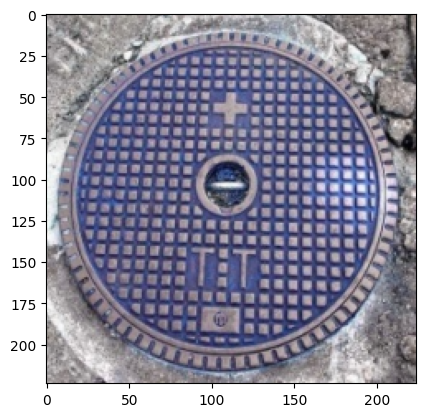

In [4]:
manhole_img = image_loader("/home/carla_client/workspace/add-aas/aas/personal/adversarial-manhole/notebooks/data/manhole/U0V5Y7E3YPIS.jpg")

plt.imshow(manhole_img[0].cpu().detach().numpy().transpose(1, 2, 0))
plt.show()

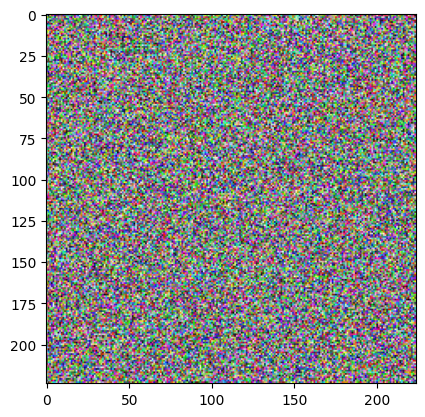

In [5]:
random_img = torch.rand_like(manhole_img)
plt.imshow(random_img[0].cpu().detach().numpy().transpose(1, 2, 0))
plt.show()

In [6]:
cnn = vgg16(weights=VGG16_Weights.DEFAULT).features.eval()

cnn

Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /home/carla_client/.cache/torch/hub/checkpoints/vgg16-397923af.pth
  8%|▊         | 41.5M/528M [00:00<00:05, 87.1MB/s]

100%|██████████| 528M/528M [00:06<00:00, 91.1MB/s] 


Sequential(
  (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU(inplace=True)
  (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU(inplace=True)
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU(inplace=True)
  (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU(inplace=True)
  (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU(inplace=True)
  (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (13): ReLU(inplace=True)
  (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (15): ReLU(inplace=True)
  (16): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (17): Conv2d(256, 512, kernel_si

In [7]:
for name, layer in cnn.named_children():
    print(name, layer)

0 Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
1 ReLU(inplace=True)
2 Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
3 ReLU(inplace=True)
4 MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
5 Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
6 ReLU(inplace=True)
7 Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
8 ReLU(inplace=True)
9 MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
10 Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
11 ReLU(inplace=True)
12 Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
13 ReLU(inplace=True)
14 Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
15 ReLU(inplace=True)
16 MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
17 Conv2d(256, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
18 ReLU(inplace=True)
19 Conv2d(512, 512, kernel_size=(3, 3)

In [8]:
# create a module to normalize input image so we can easily put it in a
# ``nn.Sequential``
class Normalization(nn.Module):
    def __init__(self, mean, std):
        super(Normalization, self).__init__()
        # .view the mean and std to make them [C x 1 x 1] so that they can
        # directly work with image Tensor of shape [B x C x H x W].
        # B is batch size. C is number of channels. H is height and W is width.
        self.mean = torch.tensor(mean).view(-1, 1, 1)
        self.std = torch.tensor(std).view(-1, 1, 1)

    def forward(self, img):
        # normalize ``img``
        return (img - self.mean) / self.std

In [9]:
def build_feature_extractor(cnn, last_conv_layer_index):
    features = []

    normalization = Normalization(torch.tensor([0.485, 0.456, 0.406]), torch.tensor([0.229, 0.224, 0.225]))
    features.append(normalization)

    i = 0
    for layer in cnn.children():
        features.append(layer)
        
        if isinstance(layer, nn.Conv2d):
            i += 1
            if i == last_conv_layer_index:
                break

    return nn.Sequential(*features)

In [10]:
vgg16_features = build_feature_extractor(cnn, 4).to(device)
vgg16_features

/home/carla_client/.local/lib/python3.8/site-packages/torch/utils/_device.py:78: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  return func(*args, **kwargs)


Sequential(
  (0): Normalization()
  (1): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (2): ReLU(inplace=True)
  (3): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (4): ReLU(inplace=True)
  (5): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (6): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (7): ReLU(inplace=True)
  (8): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
)

In [11]:
manhole_features = vgg16_features(manhole_img)
manhole_features.shape

torch.Size([1, 128, 112, 112])

In [12]:
# Create a loss module that computes the content loss
class ContentLoss(nn.Module):
    def __init__(self, target):
        super(ContentLoss, self).__init__()
        # we 'detach' the target content from the tree used
        self.target = target.detach()

    def forward(self, input):
        return F.mse_loss(input, self.target)

content_loss = ContentLoss(manhole_features)

100%|██████████| 50/50 [00:00<00:00, 94.53it/s] 


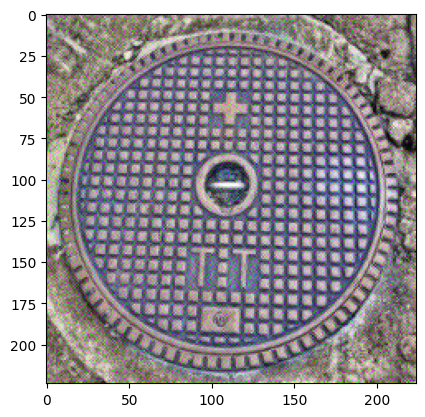

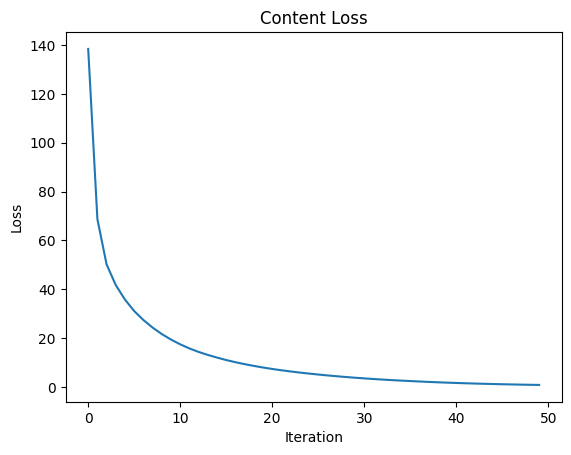

In [14]:
from tqdm import tqdm
# Create optimization pipeline
input_img = torch.rand_like(random_img, requires_grad=True)

optimizer = optim.Adam([input_img], lr=0.1)

intermediate_results = []
losses = []

# Run the optimization
num_steps = 50
for i in tqdm(range(num_steps), total=num_steps):
    optimizer.zero_grad()
    input_features = vgg16_features(input_img)
    loss = content_loss(input_features)
    loss.backward()
    optimizer.step()

    # Clip the image to be in the range [0, 1]
    input_img.data.clamp_(0, 1)
    intermediate_results.append(transforms.ToPILImage()(input_img.clone().squeeze(0)).resize((128, 128)))

    losses.append(loss.item())

plt.imshow(input_img[0].cpu().detach().numpy().transpose(1, 2, 0))
plt.show()

# Plot Loss
plt.plot(losses)
plt.xlabel("Iteration")
plt.ylabel("Loss")
plt.title("Content Loss")
plt.show()

In [15]:
# Create animation showing the optimization process
import matplotlib.animation as animation
from IPython.display import HTML

fig = plt.figure()
ims = [[plt.imshow(img, animated=True)] for img in intermediate_results]
ani = animation.ArtistAnimation(fig, ims, interval=50, blit=True, repeat_delay=1000)
HTML(ani.to_jshtml())

Animation size has reached 21039388 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [17]:
import os
manhole_candidate_path = "/home/carla_client/workspace/add-aas/aas/personal/adversarial-manhole/notebooks/data/manhole"

# Load the candidate images
candidate_images = []
for filename in os.listdir(manhole_candidate_path):
    candidate_img = image_loader(f"{manhole_candidate_path}/{filename}")
    candidate_images.append(candidate_img)

candidate_images = torch.cat(candidate_images, dim=0)
print(candidate_images.shape)

torch.Size([10, 3, 224, 224])


In [18]:
class ArgMinContentLoss(nn.Module):
    def __init__(self, candidate_images, feature_extractor):
        super(ArgMinContentLoss, self).__init__()
        self.feature_extractor = feature_extractor
        self.candidate_count = candidate_images.shape[0]
        self.candidates_features = feature_extractor(candidate_images).detach().view(self.candidate_count, -1)
        

    def forward(self, input_img):
        input_features = self.feature_extractor(input_img).view(1, -1).repeat(self.candidate_count, 1)

        mean_mae_losses = torch.mean(torch.abs(input_features - self.candidates_features), dim=1)

        min_loss, min_index = torch.min(mean_mae_losses, dim=0)

        return min_loss, min_index

In [20]:
argmin_content_loss = ArgMinContentLoss(candidate_images, vgg16_features)

In [21]:
argmin_content_loss.candidates_features.shape

torch.Size([10, 1605632])

 38%|███▊      | 19/50 [00:00<00:00, 95.40it/s]

8.852252006530762 tensor(0, device='cuda:3')
6.0676679611206055 tensor(0, device='cuda:3')
4.998236179351807 tensor(0, device='cuda:3')
4.395987510681152 tensor(0, device='cuda:3')
3.9518001079559326 tensor(0, device='cuda:3')
3.6070427894592285 tensor(0, device='cuda:3')
3.323585033416748 tensor(0, device='cuda:3')
3.0836021900177 tensor(0, device='cuda:3')
2.8688952922821045 tensor(0, device='cuda:3')
2.6818103790283203 tensor(0, device='cuda:3')
2.5182385444641113 tensor(0, device='cuda:3')
2.382155179977417 tensor(0, device='cuda:3')
2.25227952003479 tensor(0, device='cuda:3')
2.131131887435913 tensor(0, device='cuda:3')
2.019625663757324 tensor(0, device='cuda:3')
1.915191650390625 tensor(0, device='cuda:3')
1.8170899152755737 tensor(0, device='cuda:3')
1.7304072380065918 tensor(0, device='cuda:3')
1.6525059938430786 tensor(0, device='cuda:3')


 82%|████████▏ | 41/50 [00:00<00:00, 103.79it/s]

1.5762629508972168 tensor(0, device='cuda:3')
1.5083074569702148 tensor(0, device='cuda:3')
1.4436583518981934 tensor(0, device='cuda:3')
1.3782256841659546 tensor(0, device='cuda:3')
1.3251491785049438 tensor(0, device='cuda:3')
1.2768617868423462 tensor(0, device='cuda:3')
1.2302204370498657 tensor(0, device='cuda:3')
1.1884698867797852 tensor(0, device='cuda:3')
1.1515311002731323 tensor(0, device='cuda:3')
1.1190860271453857 tensor(0, device='cuda:3')
1.0906422138214111 tensor(0, device='cuda:3')
1.0698670148849487 tensor(0, device='cuda:3')
1.0497995615005493 tensor(0, device='cuda:3')
1.0351805686950684 tensor(0, device='cuda:3')
1.015019416809082 tensor(0, device='cuda:3')
1.0128161907196045 tensor(0, device='cuda:3')
0.9952121376991272 tensor(0, device='cuda:3')
0.9860309958457947 tensor(0, device='cuda:3')
0.9718668460845947 tensor(0, device='cuda:3')
0.9658063054084778 tensor(0, device='cuda:3')
0.9530290961265564 tensor(0, device='cuda:3')
0.9454390406608582 tensor(0, device

100%|██████████| 50/50 [00:00<00:00, 102.59it/s]


0.9370270371437073 tensor(0, device='cuda:3')
0.931445300579071 tensor(0, device='cuda:3')
0.9234190583229065 tensor(0, device='cuda:3')
0.9165617823600769 tensor(0, device='cuda:3')
0.9035733938217163 tensor(0, device='cuda:3')
0.9010221362113953 tensor(0, device='cuda:3')
0.8916168212890625 tensor(0, device='cuda:3')
0.8824237585067749 tensor(0, device='cuda:3')
0.8749753832817078 tensor(0, device='cuda:3')


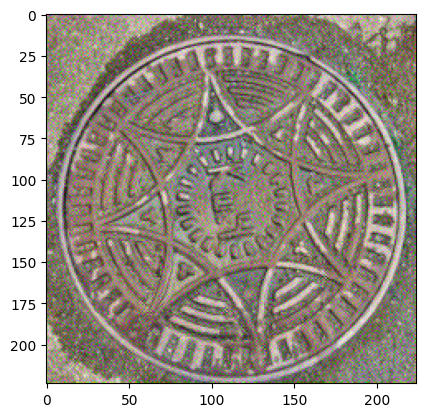

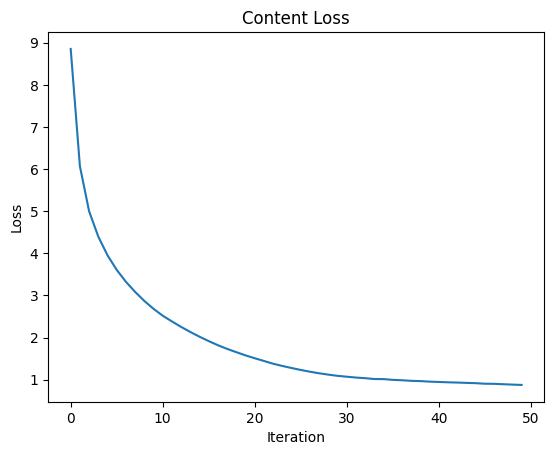

In [22]:
from tqdm import tqdm
# Create optimization pipeline
new_input_img = torch.rand_like(random_img, requires_grad=True)

new_optimizer = optim.Adam([new_input_img], lr=0.1)

intermediate_results = []
losses = []

# Run the optimization
num_steps = 50
for i in tqdm(range(num_steps), total=num_steps):
    new_optimizer.zero_grad()
    loss, min_index = argmin_content_loss(new_input_img)
    print(loss.item(), min_index)
    loss.backward()
    new_optimizer.step()

    # Clip the image to be in the range [0, 1]
    new_input_img.data.clamp_(0, 1)
    intermediate_results.append(transforms.ToPILImage()(new_input_img.clone().squeeze(0)).resize((128, 128)))

    losses.append(loss.item())

plt.imshow(new_input_img[0].cpu().detach().numpy().transpose(1, 2, 0))
plt.show()

# Plot Loss
plt.plot(losses)
plt.xlabel("Iteration")
plt.ylabel("Loss")
plt.title("Content Loss")
plt.show()

In [39]:
new_input_img.shape

torch.Size([1, 3, 256, 256])